# Imports

In [1]:
from diffusers import DiffusionPipeline, UNet2DConditionModel
from transformers import CLIPTextModel
from utils import image_grid
import torch

/home/shane/projects/.venv/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


# Parameters

In [2]:
model_id = "stabilityai/stable-diffusion-2-1"
ft_model_name = "shane4"
no_imgs = 4
num_inference_steps = 100
guidance_scale = 15
cols = no_imgs // 2 if no_imgs // 2 <= 5 else 5
rows = no_imgs // cols if no_imgs // cols % 2 == 0 else no_imgs // cols + 1
prompt = "a photo of shane male"
n_prompt = "bad, deformed, ugly, bad anatomy, cartoon, animated, scary, wrinkles, duplicate, double"

# Function

In [3]:
def infer_from_ckpt(checkpoint_folder):
    unet = UNet2DConditionModel.from_pretrained("./models/shane/stable_diffusion_weights/"+ft_model_name+"/"+checkpoint_folder+"/unet")
    text_encoder = CLIPTextModel.from_pretrained("./models/shane/stable_diffusion_weights/"+ft_model_name+"/"+checkpoint_folder+"/text_encoder")
    pipeline = DiffusionPipeline.from_pretrained(model_id, unet=unet, text_encoder=text_encoder)
    pipeline.to("cuda")
    image = [0] * no_imgs
    for i in range(no_imgs):
        image[i] = pipeline(prompt, negative_prompt=n_prompt, num_inference_steps=num_inference_steps, guidance_scale=guidance_scale).images[0]
    return image

In [4]:
images = infer_from_ckpt("checkpoint-1200")
image_grid(images)

/home/shane/projects/.venv/lib/python3.10/site-packages/safetensors/torch.py:99: UserWarning: TypedStorage is deprecated. It will be removed in the future and UntypedStorage will be the only storage class. This should only matter to you if you are using storages directly.  To access UntypedStorage directly, use tensor.untyped_storage() instead of tensor.storage()
  with safe_open(filename, framework="pt", device=device) as f:
/home/shane/projects/.venv/lib/python3.10/site-packages/torch/_utils.py:776: UserWarning: TypedStorage is deprecated. It will be removed in the future and UntypedStorage will be the only storage class. This should only matter to you if you are using storages directly.  To access UntypedStorage directly, use tensor.untyped_storage() instead of tensor.storage()
  return self.fget.__get__(instance, owner)()
/home/shane/projects/.venv/lib/python3.10/site-packages/torch/storage.py:899: UserWarning: TypedStorage is deprecated. It will be removed in the future and Untype

╭─────────────────────────────── Traceback (most recent call last) ────────────────────────────────╮
│ in <module>:1                                                                                    │
│                                                                                                  │
│ ❱ 1 images = infer_from_ckpt("checkpoint-1200")                                                  │
│   2 image_grid(images)                                                                           │
│   3                                                                                              │
│                                                                                                  │
│ in infer_from_ckpt:8                                                                             │
│                                                                                                  │
│    5 │   pipeline.to("cuda")                                                                     │
│    6 │   image = [0] * no_imgs                                                                   │
│    7 │   for i in range(no_imgs):                                                                │
│ ❱  8 │   │   image[i] = pipeline(prompt, negative_prompt=n_prompt, num_inference_steps=num_in    │
│    9 │   return image                                                                            │
│   10                                                                                             │
│                                                                                                  │
│ /home/shane/projects/.venv/lib/python3.10/site-packages/torch/utils/_contextlib.py:115 in        │
│ decorate_context                                                                                 │
│                                                                                                  │
│   112 │   @functools.wraps(func)                                                                 │
│   113 │   def decorate_context(*args, **kwargs):                                                 │
│   114 │   │   with ctx_factory():                                                                │
│ ❱ 115 │   │   │   return func(*args, **kwargs)                                                   │
│   116 │                                                                                          │
│   117 │   return decorate_context                                                                │
│   118                                                                                            │
│                                                                                                  │
│ /home/shane/projects/.venv/lib/python3.10/site-packages/diffusers/pipelines/stable_diffusion/pip │
│ eline_stable_diffusion.py:702 in __call__                                                        │
│                                                                                                  │
│   699 │   │   │   has_nsfw_concept = None                                                        │
│   700 │   │   elif output_type == "pil":                                                         │
│   701 │   │   │   # 8. Post-processing                                                           │
│ ❱ 702 │   │   │   image = self.decode_latents(latents)                                           │
│   703 │   │   │                                                                                  │
│   704 │   │   │   # 9. Run safety checker                                                        │
│   705 │   │   │   image, has_nsfw_concept = self.run_safety_checker(image, device, prompt_embe   │
│                                                                                                  │
│ /home/shane/projects/.venv/lib/python3.10/site-packages/diffusers/pipelines/stable_diffusion/pip │
│ eline_stable_diffusion.py:435 in decode_latents            

# Inference

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

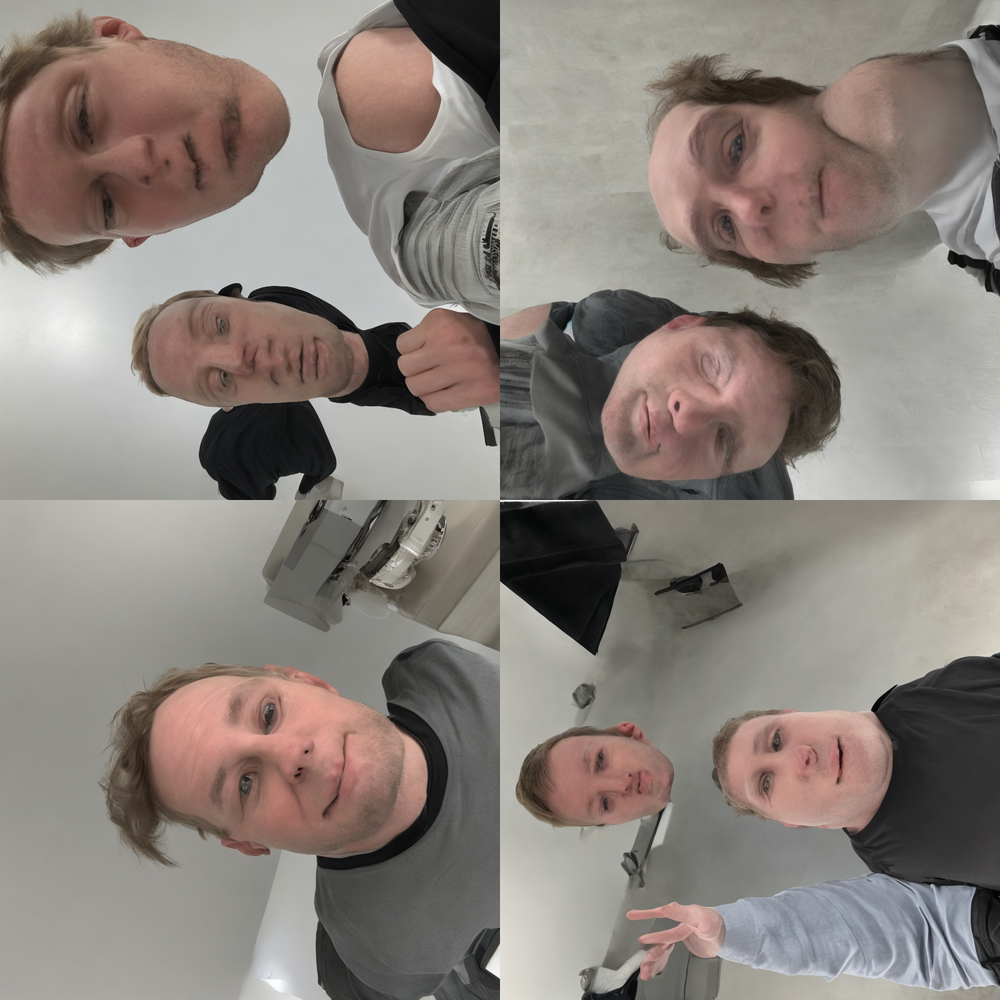

In [32]:
images = infer_from_ckpt("checkpoint-200")
image_grid(images)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

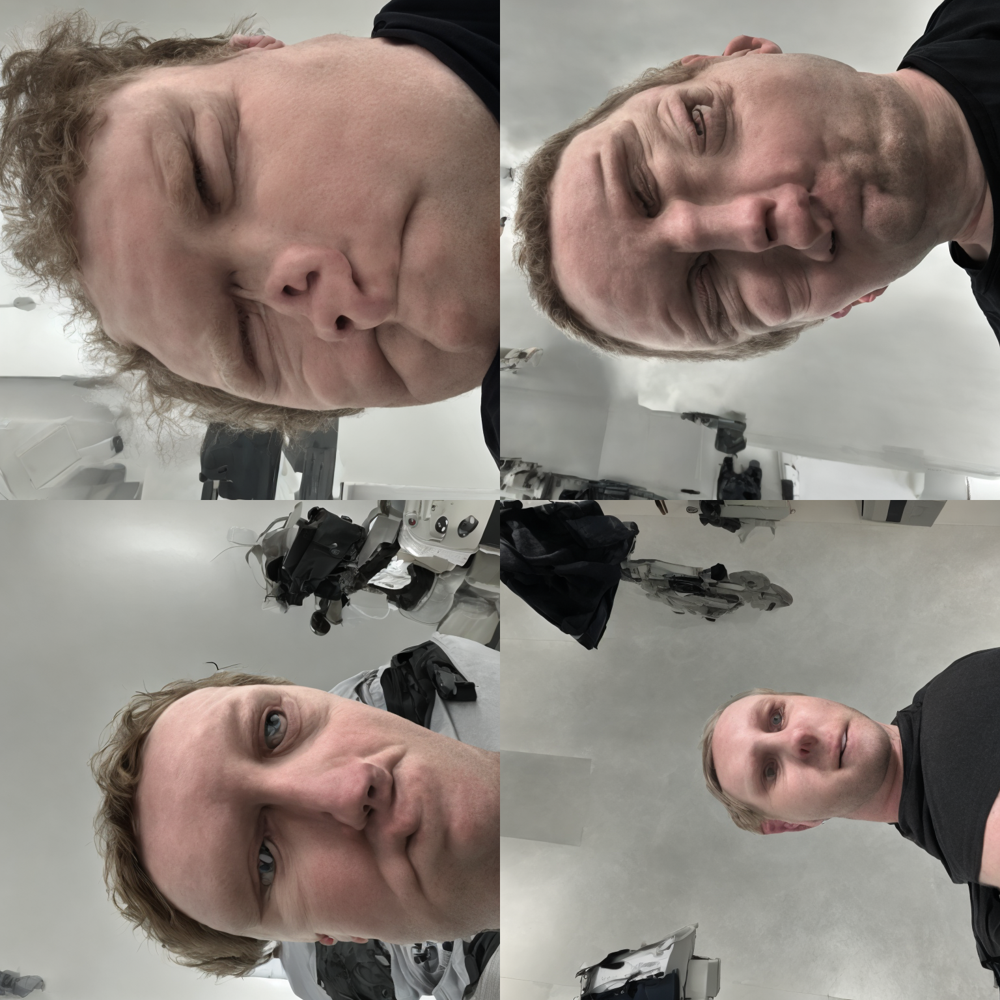

In [33]:
images = infer_from_ckpt("checkpoint-400")
image_grid(images)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

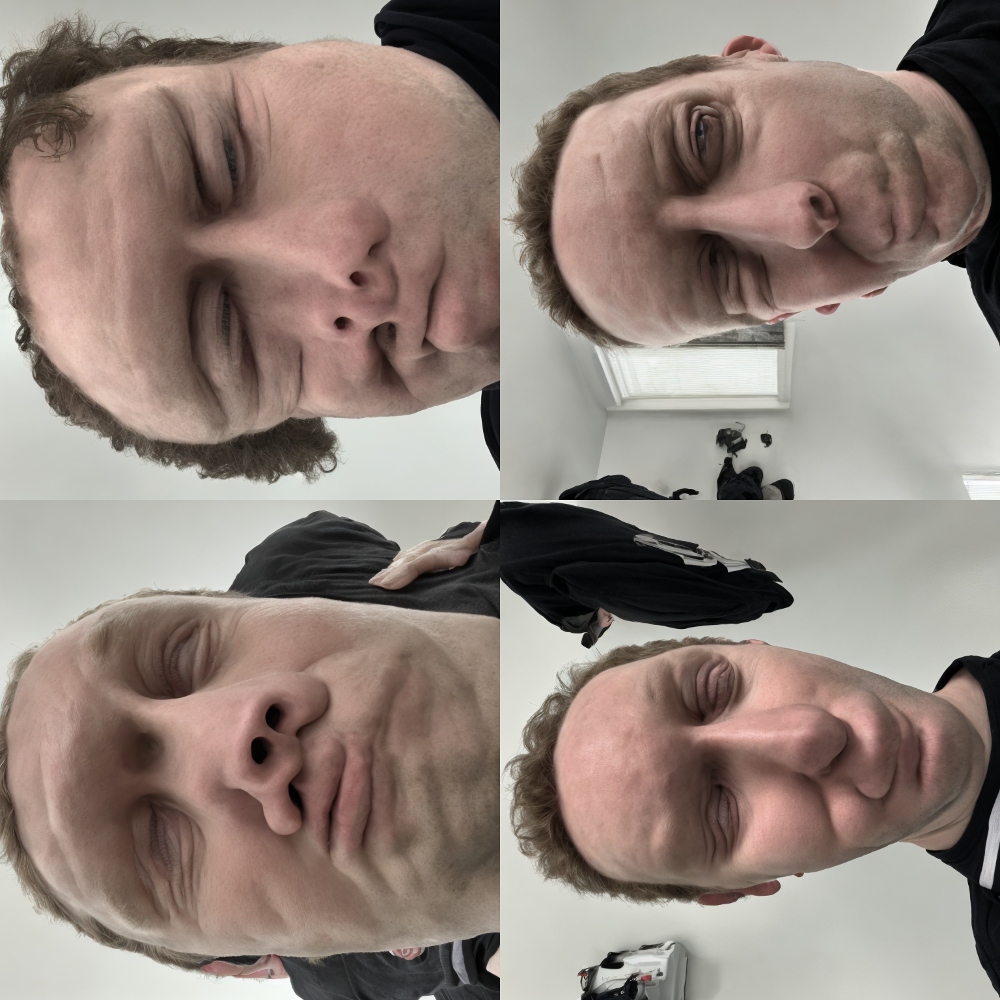

In [34]:
images = infer_from_ckpt("checkpoint-600")
image_grid(images)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

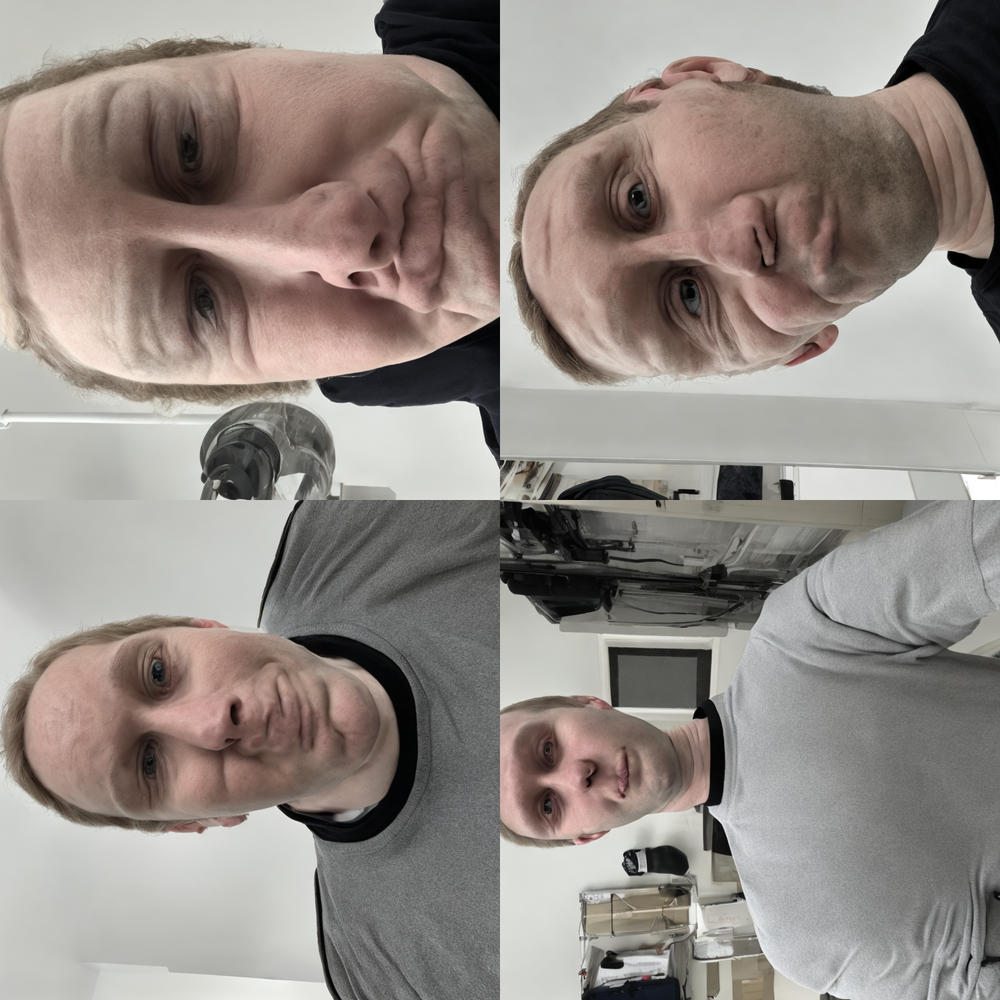

In [35]:
images = infer_from_ckpt("checkpoint-800")
image_grid(images)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

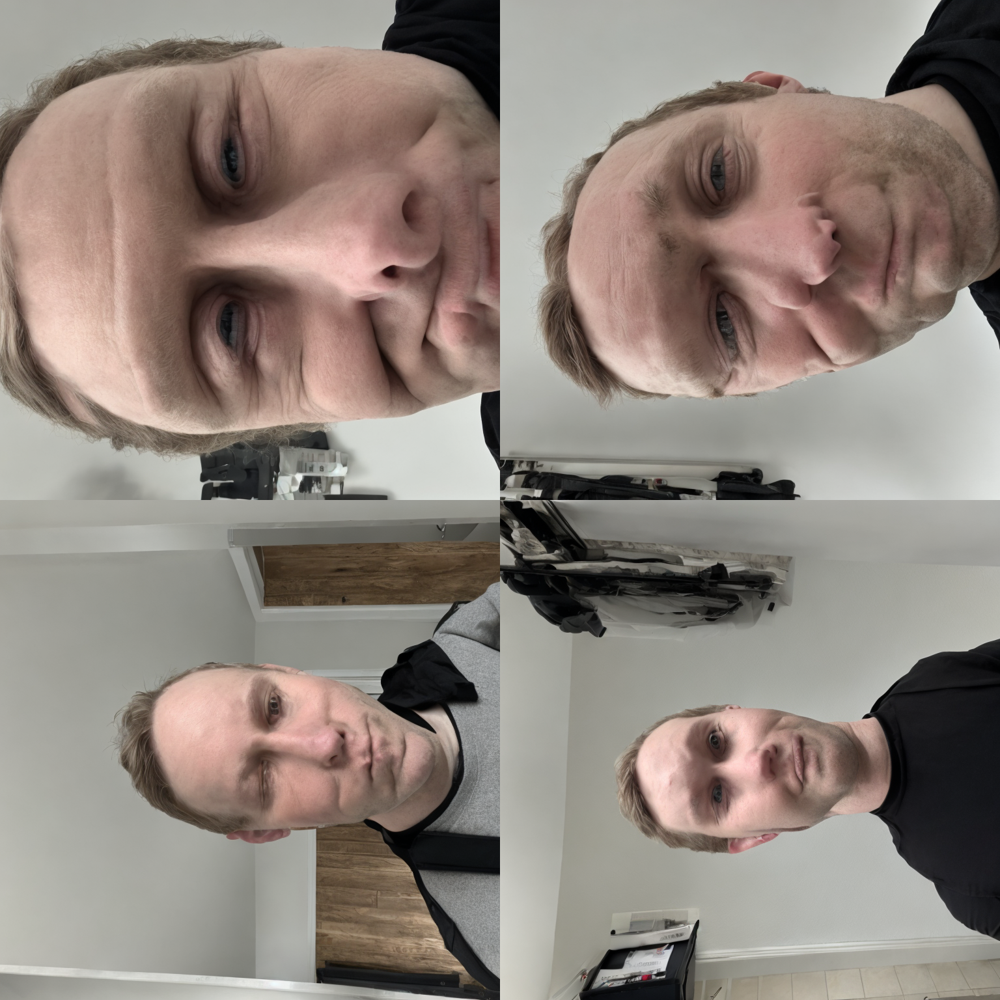

In [36]:
images = infer_from_ckpt("checkpoint-1000")
image_grid(images)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

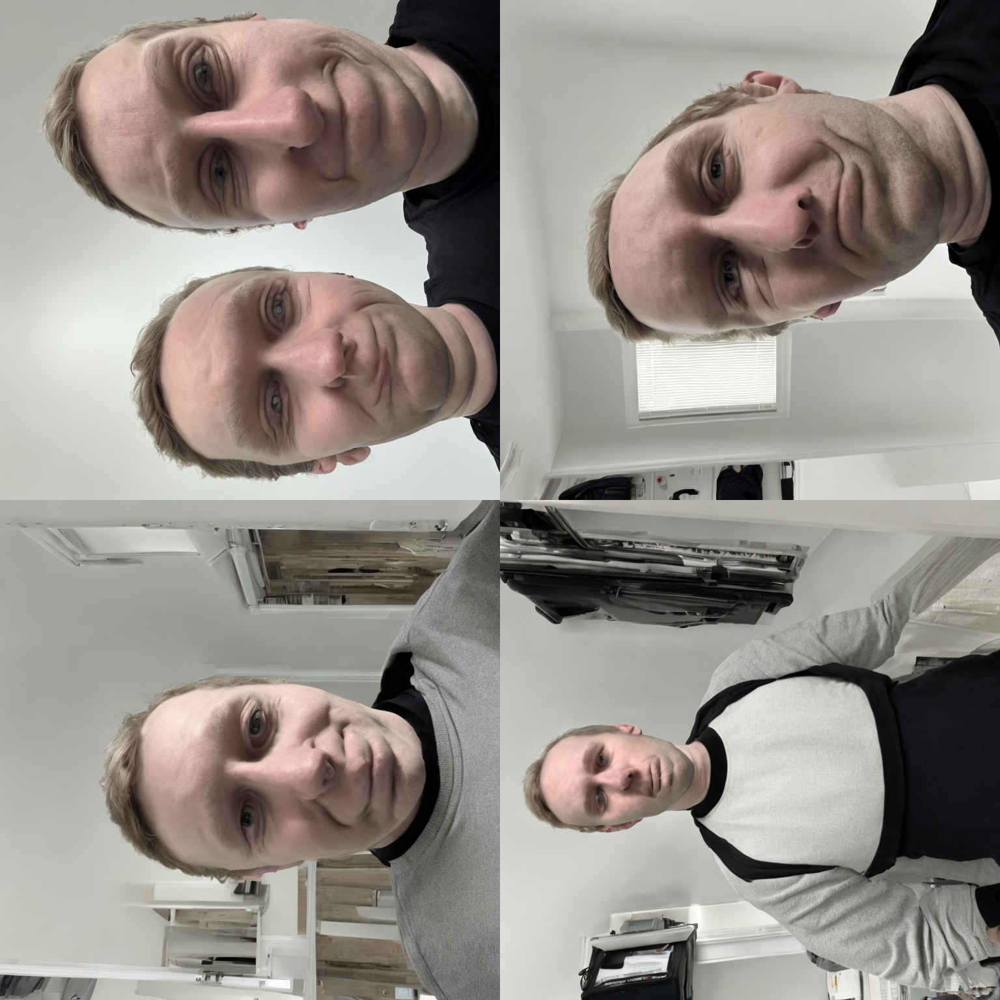

In [37]:
images = infer_from_ckpt("checkpoint-1200")
image_grid(images)